In [1]:
#attempting to reproduce results

seed_value= 5

# 1. Set the `PYTHONHASHSEED` environment variable at a fixed value
import os
os.environ['PYTHONHASHSEED']=str(seed_value)

# 2. Set the `python` built-in pseudo-random generator at a fixed value
import random
random.seed(seed_value)

# 3. Set the `numpy` pseudo-random generator at a fixed value
import numpy as np
np.random.seed(seed_value)

# 4. Set the `tensorflow` pseudo-random generator at a fixed value
import tensorflow as tf
tf.random.set_seed(seed_value)
# for later versions: 
# tf.compat.v1.set_random_seed(seed_value)

# 5. Configure a new global `tensorflow` session
from keras import backend as K
session_conf = tf.compat.v1.ConfigProto(intra_op_parallelism_threads=1, inter_op_parallelism_threads=1)
sess = tf.compat.v1.Session(graph=tf.compat.v1.get_default_graph(), config=session_conf)
tf.compat.v1.keras.backend.set_session(sess)

2021-12-02 11:54:27.884173: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
import pandas as pd
import numpy as np
from tensorflow.keras.applications import mobilenet_v2
from tensorflow.keras.preprocessing import image
import sys
np.set_printoptions(threshold=sys.maxsize)
from tqdm import tqdm
tqdm.pandas()
from IPython.display import Image
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical, load_img, img_to_array
from tensorflow.keras.models import Model
import pickle


# Data Organization & EDA

In [3]:
# data = pd.read_csv('final_5000_nonulls.csv')

In [4]:
# animal_data_reworked = data.drop(labels='pixels', axis=1)

In [5]:
# def prepare_image(img_path):

#     full_img_path = 'species_photos/nacti-unzipped/'+img_path
#     img = image.load_img(full_img_path, target_size=(224, 224))
#     x = image.img_to_array(img)
#     x = np.expand_dims(x, axis=0)
#     x = mobilenet_v2.preprocess_input(x)
#     return x



In [6]:
# animal_data_reworked['pixels'] = tqdm(animal_data_reworked.filename.progress_apply(prepare_image))

In [7]:
# import pickle
# with open('animal_image_dataset.pkl', 'wb') as f:
#     pickle.dump(animal_data_reworked, f)

In [8]:
with open('animal_image_dataset.pkl', 'rb') as g:
    df = pickle.load(g)

In [9]:
df.loc[0,'pixels'].shape

(1, 224, 224, 3)

# Visualizing the dataset targets

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'american black bear'),
  Text(1, 0, 'coyote'),
  Text(2, 0, 'cougar'),
  Text(3, 0, 'moose'),
  Text(4, 0, 'mule deer'),
  Text(5, 0, 'raccoon'),
  Text(6, 0, 'empty'),
  Text(7, 0, 'elk'),
  Text(8, 0, 'american red squirrel'),
  Text(9, 0, 'unidentified chipmunk')])

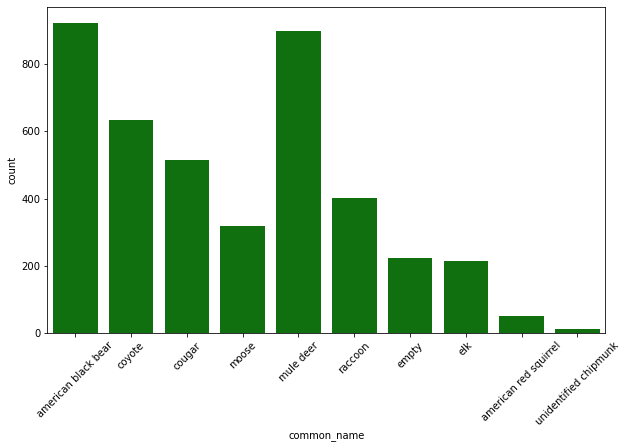

In [10]:
plt.figure(figsize=(10,6))
sns.countplot(x='common_name', data=df,order =['american black bear', 'coyote','cougar', 'moose', 'mule deer', 'raccoon', 'empty', 'elk', 'american red squirrel', 'unidentified chipmunk'],
             color='green')
plt.xticks(rotation=45)

<AxesSubplot:xlabel='dangerous', ylabel='count'>

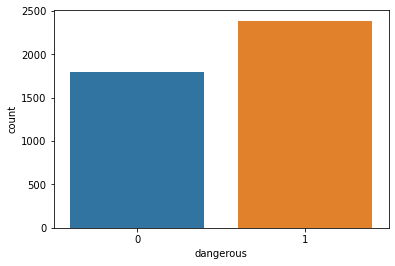

In [11]:
sns.countplot(x='dangerous', data=df)

In [12]:
len(df[df['dangerous']==1])/len(df)

0.570336756627657

# Testing initial accuracy of MobileNetV2

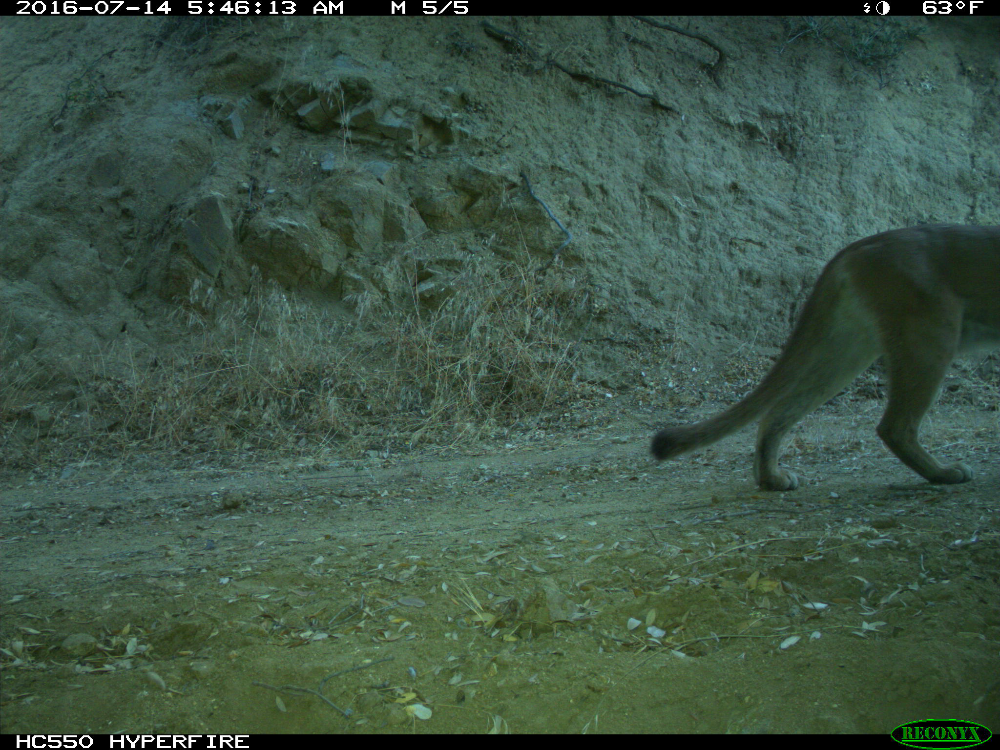

In [13]:
from PIL import Image

Image.open('species_photos/nacti-unzipped/'+df.loc[0, 'filename'])

In [14]:
#attempting mobilenet prediction

model = mobilenet_v2.MobileNetV2(weights='imagenet',)
x = df.loc[0, 'pixels']

out = model.predict(x)

print('Predicted:', mobilenet_v2.decode_predictions(out))

Predicted: [[('n02125311', 'cougar', 0.17630762), ('n02115641', 'dingo', 0.06153755), ('n02487347', 'macaque', 0.051181674), ('n02120079', 'Arctic_fox', 0.046341933), ('n01877812', 'wallaby', 0.031110514)]]


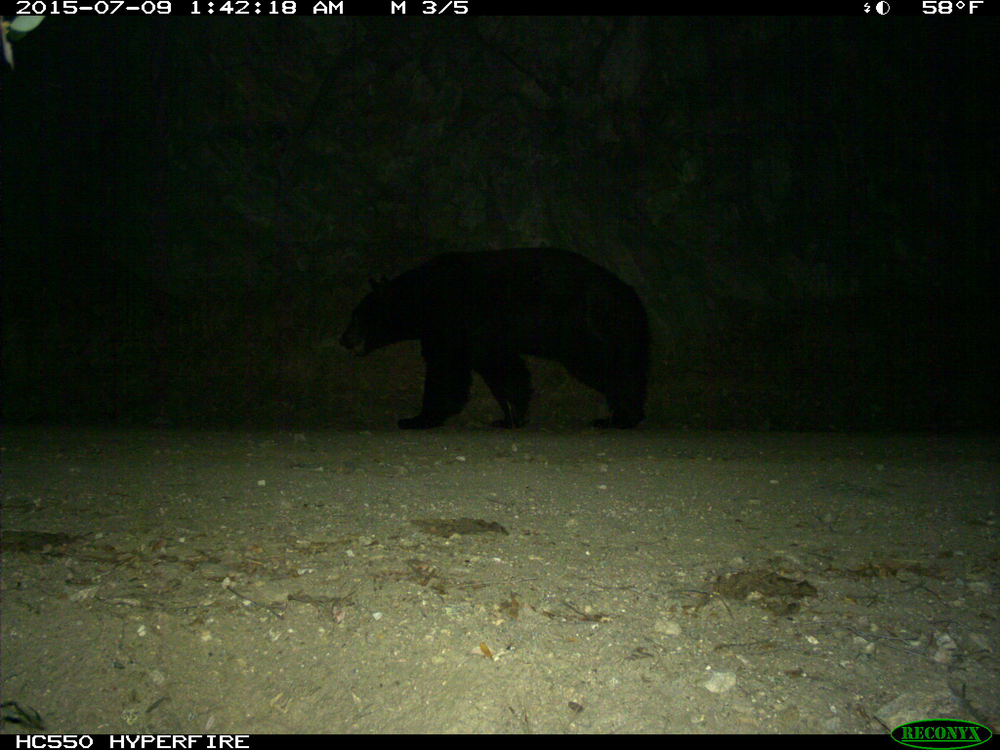

In [15]:
Image.open('species_photos/nacti-unzipped/'+df.loc[461, 'filename'])

In [16]:
x2 = df.loc[461, 'pixels']

out = model.predict(x2)

print('Predicted:', mobilenet_v2.decode_predictions(out))

Predicted: [[('n02396427', 'wild_boar', 0.23660463), ('n02133161', 'American_black_bear', 0.13419421), ('n01883070', 'wombat', 0.13192084), ('n02454379', 'armadillo', 0.08284668), ('n02134418', 'sloth_bear', 0.081552885)]]


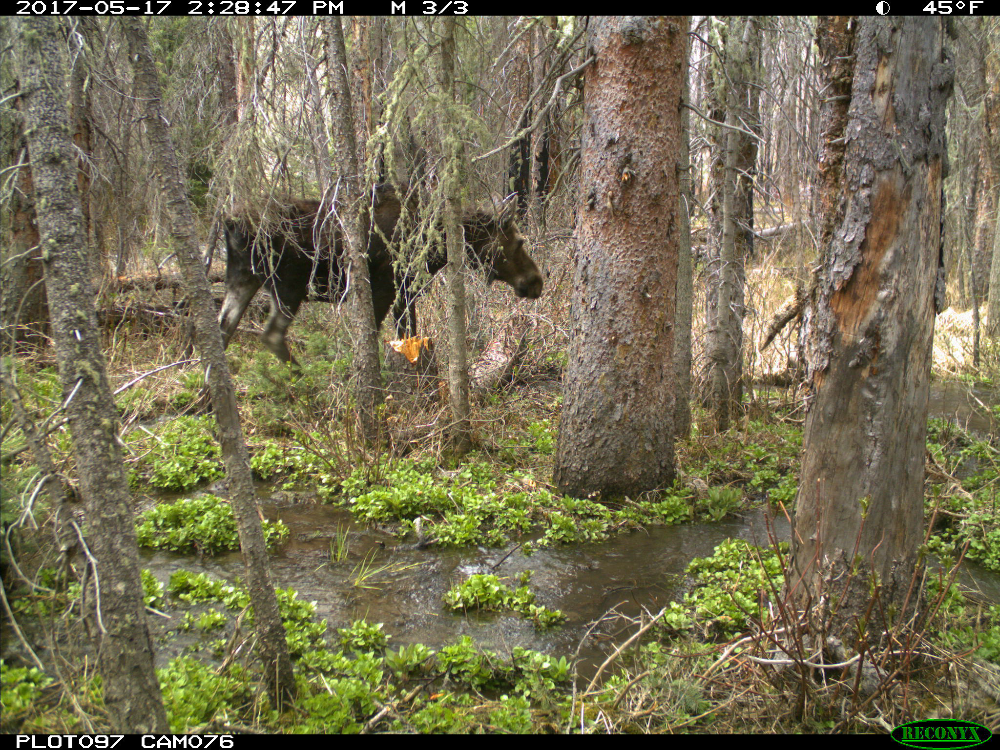

In [17]:
Image.open('species_photos/nacti-unzipped/'+df.loc[319, 'filename'])

In [18]:
x3 = df.loc[461, 'pixels']

out = model.predict(x3)

print('Predicted:', mobilenet_v2.decode_predictions(out))

Predicted: [[('n02396427', 'wild_boar', 0.23660463), ('n02133161', 'American_black_bear', 0.13419421), ('n01883070', 'wombat', 0.13192084), ('n02454379', 'armadillo', 0.08284668), ('n02134418', 'sloth_bear', 0.081552885)]]


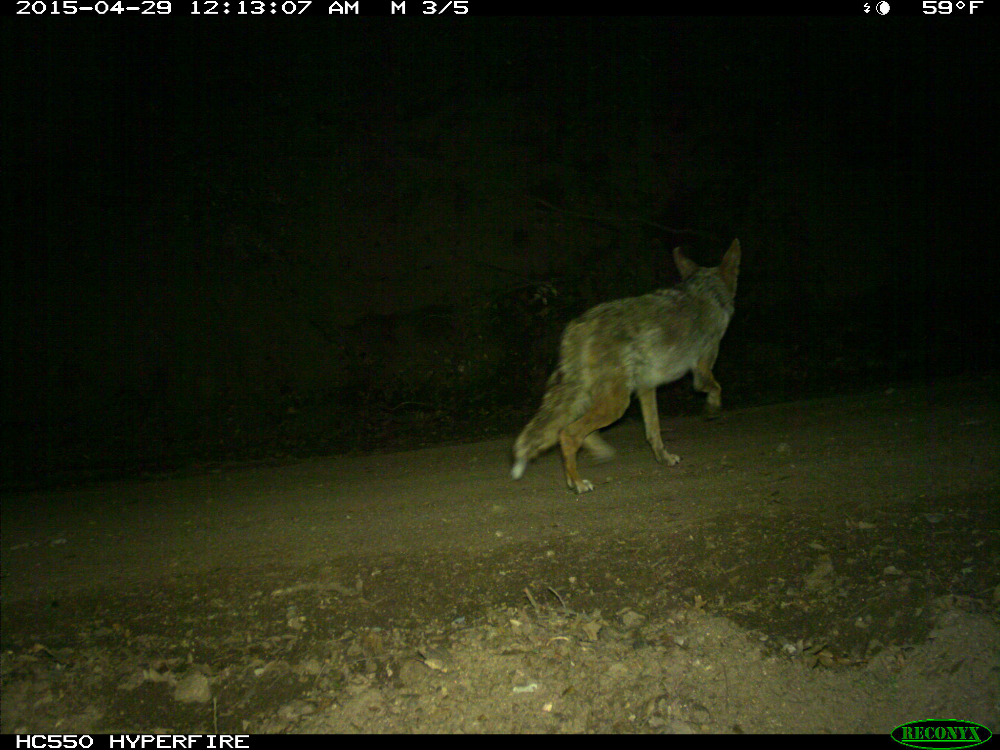

In [19]:
Image.open('species_photos/nacti-unzipped/'+df.loc[2976, 'filename'])

In [20]:
x4 = df.loc[2976, 'pixels']

out = model.predict(x4)

print('Predicted:', mobilenet_v2.decode_predictions(out))

Predicted: [[('n02114855', 'coyote', 0.671455), ('n02120505', 'grey_fox', 0.120739155), ('n02119022', 'red_fox', 0.07515834), ('n02326432', 'hare', 0.031527523), ('n02115913', 'dhole', 0.017256614)]]


# Splitting Data into Train/Val/Holdout

In [21]:
def squeeze_pixels(row):
    return np.squeeze(row)

df['pixels'] = df['pixels'].apply(squeeze_pixels)

In [22]:
X = df['pixels']
Y = df['dangerous']

In [23]:
Y.shape

(4187,)

In [24]:
x_train, x_test, y_train, y_test = (train_test_split(X, Y, 
                                                     test_size = .2, random_state = 5))
x_tr, x_val, y_tr, y_val = (train_test_split(x_train, y_train, test_size=.2, random_state=5))

print(x_tr.shape)
print(y_tr.shape)
print(x_val.shape)
print(y_val.shape)
print(x_test.shape)
print(y_test.shape)

(2679,)
(2679,)
(670,)
(670,)
(838,)
(838,)


# Establishing Baseline Model

In [ ]:
def grayscale(data, dtype='float32'):
    "Luma coding is weighted average common in video systems"
    r, g, b = np.asarray(.3, dtype=dtype), np.asarray(.59, dtype=dtype), np.asarray(.11, dtype=dtype)
    rst = r * data[ :, :, 0] + g * data[ :, :, 1] + b * data[ :, :, 2]
    # Add channel dimension
    rst = np.expand_dims(rst, axis=2)
    return rst

x_tr_gray = x_tr.apply(grayscale)
x_val_gray = x_val.apply(grayscale)

In [ ]:
x_tr[1].shape

In [ ]:
def flatten_for_baseline(row):
    return row.ravel(order='C')

x_tr_flat = x_tr_gray.apply(flatten_for_baseline).to_numpy()
x_val_flat = x_val_gray.apply(flatten_for_baseline).to_numpy()



In [ ]:
x_tr_flatarray = np.reshape(x_tr_flat[0],(1,50176))

for row in x_tr_flat[1:]:
    x_tr_flatarray=np.append(x_tr_flatarray, np.reshape(row, (1,50176)), axis=0)

x_tr_flatarray.shape

In [ ]:
x_val_flatarray = np.reshape(x_val_flat[0],(1,50176))

for row in x_val_flat[1:]:
    x_val_flatarray=np.append(x_val_flatarray, np.reshape(row, (1,50176)), axis=0)
    
x_val_flatarray.shape


In [25]:
import copy
y_tr_notnumpy = copy.deepcopy(y_tr)
y_val_notnumpy = copy.deepcopy(y_val)
y_test_notnumpy = copy.deepcopy(y_test)


y_tr_notnumpy.head(3)

3357    1
1825    1
2119    1
Name: dangerous, dtype: int64

In [26]:
y_tr = y_tr.to_numpy()
y_val = y_val.to_numpy()
y_test = y_test.to_numpy()

In [27]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, precision_score, recall_score

In [ ]:
rf = RandomForestClassifier()
rf.fit(x_tr_flatarray, y_tr)
rf_preds = rf.predict(x_val_flatarray)
rf.score(x_val_flatarray, y_val)

In [ ]:
confusion_matrix(y_val, rf_preds)

In [ ]:
print(classification_report(y_val, rf_preds))

In [ ]:
baseline_preds = pd.concat([pd.DataFrame(y_val, columns=['true_value']), pd.DataFrame(rf_preds,columns=['rf_pred'])],axis=1)

In [ ]:
baseline_preds['correct'] = np.where(baseline_preds['true_value']==baseline_preds['rf_pred'],1,0)

In [ ]:
baseline_preds[baseline_preds.correct==0]

In [ ]:
#how to get indices in order to go back and look at the images??

# Basic CNN - No Transfer Learning

In [ ]:
# x_tr, x_val, y_tr, y_val
x_tr.iloc[0].shape

In [ ]:
df.loc[0,'pixels'].shape

In [ ]:
#example of what we're feeding in
image = x_tr[1]
image = image / 2 + 0.5
plt.figure(figsize=(10,10))
plt.imshow(image)

In [28]:
# simple keras model
import tensorflow.keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, GlobalAveragePooling2D, InputLayer

x_tr_stacked = np.stack(x_tr)
x_val_stacked = np.stack(x_val)
x_test_stacked = np.stack(x_test)

In [ ]:
NN = Sequential([InputLayer(input_shape=x_tr_stacked.shape[1:]),
               Conv2D(filters=10, kernel_size=3, activation='relu', padding='same'),
               MaxPooling2D(),
               Conv2D(filters=20, kernel_size=3, activation='relu', padding='same'),
               MaxPooling2D(),
               Conv2D(filters=30, kernel_size=3, activation='relu', padding='same'),
               GlobalAveragePooling2D(),
               Flatten(),
               Dense(20, activation='relu'),
               Dense(1, activation='sigmoid')])

In [ ]:
NN.compile(
    loss='binary_crossentropy',
    optimizer='adam',
    metrics=['accuracy', 'Precision', 'Recall'],
)

In [ ]:
NN.summary()

In [ ]:
NN.fit(x_tr_stacked, y_tr, epochs=10, verbose=1, validation_split=0.25,
       callbacks=[
           tensorflow.keras.callbacks.ModelCheckpoint(
               'models/mnist.{epoch:02d}-{val_loss:.2f}.hdf5',
               save_best_only=True)
       ])

In [ ]:
preds = NN.predict(x_val_stacked).flatten()
pred_classes = np.int8(preds >= .5)

print('Accuracy:', accuracy_score(y_val, pred_classes))
print('Precision:', precision_score(y_val, pred_classes))
print('Recall:', recall_score(y_val,pred_classes))

# Improving Predictions with Transfer Learning

### Tracking Iteration Improvements Here

- Model1: base MobilenetV2, 2 Conv2d layers (10 and 20 filters, relu) with MaxPooling, 2 Dense layers (100, 50, relu)
    - Accuracy: 0.8
    - Precision: 0.77 
    - Recall: 0.94
- Added Early Stopping to Model1, completed 9 epochs:
    - Accuracy: 0.86
    - Precision: 0.87
    - Recall: 0.91
    
attempted adding Conv layer, attempted smaller batch size

In [ ]:
base_model = mobilenet_v2.MobileNetV2(weights='imagenet', include_top=False, input_shape=(224,224,3)) 
for layer in base_model.layers:
    layer.trainable = False  

x = base_model.output
x = Conv2D(filters=10, kernel_size=3, activation='relu', padding='same')(x)
x = MaxPooling2D()(x)
x = Conv2D(filters=20, kernel_size=3, activation='relu', padding='same')(x)
x = MaxPooling2D()(x)
x = Flatten()(x)
x = Dense(100, activation='relu')(x)
x = Dense(50, activation='relu')(x)
predictions = Dense(1, activation='sigmoid')(x)

transfer_model = Model(inputs=base_model.input, outputs=predictions)
transfer_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy', 'Precision', 'Recall'])
transfer_model.summary()

In [ ]:
#mobilenet + additional layers 
transfer_model.fit(x_tr_stacked,y_tr, epochs=100, verbose=1, validation_split=0.25,
       callbacks=[
           tensorflow.keras.callbacks.EarlyStopping(patience=8, verbose=1, restore_best_weights=True),
           tensorflow.keras.callbacks.ModelCheckpoint(
               'models/mnist.{epoch:02d}-{val_loss:.2f}.hdf5',
               save_best_only=True)])

In [ ]:
transfer_preds = transfer_model.predict(x_val_stacked).flatten()
transfer_pred_classes = np.int8(transfer_preds >= .5)

print('Accuracy:', accuracy_score(y_val, transfer_pred_classes))
print('Precision:', precision_score(y_val, transfer_pred_classes))
print('Recall:', recall_score(y_val,transfer_pred_classes))

#setting the batch size to 20 increased Recall slightly, with a major decrease in the other two
#adding additional convolutional layers helped Precision a lot, but brought Recall down

In [ ]:
#attempting additional iterations below

In [29]:
from tensorflow import keras

In [30]:


base_model = mobilenet_v2.MobileNetV2(weights='imagenet', include_top=False, input_shape=(224,224,3)) 
for layer in base_model.layers:
    layer.trainable = False  

x1 = base_model.output
x1 = Conv2D(filters=10, kernel_size=3, activation='relu', padding='same')(x1)
x1 = MaxPooling2D()(x1)
x1 = Conv2D(filters=20, kernel_size=3, activation='relu', padding='same')(x1)
x1 = MaxPooling2D()(x1)
x1 = Flatten()(x1)
x1 = Dense(100, activation='relu')(x1)
x1 = Dense(50, activation='relu')(x1)
predictions1 = Dense(1, activation='sigmoid')(x1)

transfer_model_slowlearning = Model(inputs=base_model.input, outputs=predictions1)
optimizer = keras.optimizers.Adam(lr=0.00001)
transfer_model_slowlearning.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy', 'Precision', 'Recall'])
transfer_model_slowlearning.summary()


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                             

/Users/ninasweeney/opt/anaconda3/lib/python3.8/site-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [31]:
transfer_model_slowlearning.fit(x_tr_stacked,y_tr, epochs=100, verbose=1, validation_split=0.25,
       callbacks=[
           tensorflow.keras.callbacks.EarlyStopping(patience=8, verbose=1, restore_best_weights=True),
           keras.callbacks.ReduceLROnPlateau(factor=.5, patience=6, verbose=1),
           tensorflow.keras.callbacks.ModelCheckpoint(
               'models/mnist.{epoch:02d}-{val_loss:.2f}.hdf5',
               save_best_only=True)])

Epoch 1/100
63/63 [==============================] - ETA: 0s - loss: 0.6899 - accuracy: 0.5595 - precision: 0.5595 - recall: 1.0000

/Users/ninasweeney/opt/anaconda3/lib/python3.8/site-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


63/63 [==============================] - 117s 2s/step - loss: 0.6899 - accuracy: 0.5595 - precision: 0.5595 - recall: 1.0000 - val_loss: 0.6619 - val_accuracy: 0.5836 - val_precision: 0.5836 - val_recall: 1.0000 - lr: 1.0000e-05
Epoch 2/100
63/63 [==============================] - 111s 2s/step - loss: 0.6549 - accuracy: 0.5595 - precision: 0.5595 - recall: 1.0000 - val_loss: 0.6373 - val_accuracy: 0.5836 - val_precision: 0.5836 - val_recall: 1.0000 - lr: 1.0000e-05
Epoch 3/100
63/63 [==============================] - 102s 2s/step - loss: 0.6273 - accuracy: 0.5595 - precision: 0.5595 - recall: 1.0000 - val_loss: 0.6109 - val_accuracy: 0.5836 - val_precision: 0.5836 - val_recall: 1.0000 - lr: 1.0000e-05
Epoch 4/100
63/63 [==============================] - 97s 2s/step - loss: 0.5960 - accuracy: 0.5655 - precision: 0.5629 - recall: 0.9991 - val_loss: 0.5830 - val_accuracy: 0.5881 - val_precision: 0.5862 - val_recall: 1.0000 - lr: 1.0000e-05
Epoch 5/100
63/63 [==============================

63/63 [==============================] - 99s 2s/step - loss: 0.1462 - accuracy: 0.9577 - precision: 0.9824 - recall: 0.9413 - val_loss: 0.3914 - val_accuracy: 0.8388 - val_precision: 0.8638 - val_recall: 0.8593 - lr: 5.0000e-06
Epoch 35/100
63/63 [==============================] - 102s 2s/step - loss: 0.1424 - accuracy: 0.9592 - precision: 0.9815 - recall: 0.9448 - val_loss: 0.3887 - val_accuracy: 0.8373 - val_precision: 0.8770 - val_recall: 0.8389 - lr: 5.0000e-06
Epoch 00035: early stopping


In [32]:
#learning rates tried: default .001, .01, .0001(best so far), .1

transfer_preds1 = transfer_model_slowlearning.predict(x_val_stacked).flatten()
transfer_pred_classes1 = np.int8(transfer_preds1 >= .25)

print('Accuracy:', accuracy_score(y_val, transfer_pred_classes1))
print('Precision:', precision_score(y_val, transfer_pred_classes1))
print('Recall:', recall_score(y_val,transfer_pred_classes1))

Accuracy: 0.8522388059701492
Precision: 0.841743119266055
Recall: 0.924433249370277


[0.5925373134328358, 0.7238805970149254, 0.835820895522388, 0.8522388059701492, 0.8567164179104477, 0.8537313432835821, 0.8522388059701492, 0.8402985074626865, 0.8298507462686567, 0.7940298507462686, 0.40746268656716417]


/Users/ninasweeney/opt/anaconda3/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


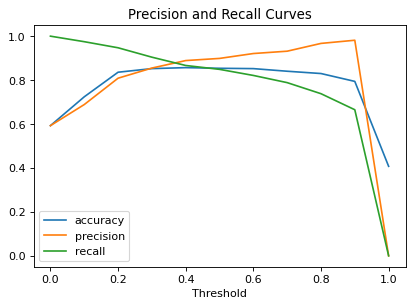

In [33]:
from sklearn.metrics import precision_recall_curve


threshold_range = np.linspace(0,1,11)
accuracies=[]
precisions=[]
recalls=[]

for i in threshold_range: 
    classes = np.int8(transfer_preds1 >= i)
    acc = accuracy_score(y_val, classes)
    prec = precision_score(y_val, classes)
    rec = recall_score(y_val,classes)
    
    accuracies.append(acc)
    precisions.append(prec)
    recalls.append(rec)
    


print(accuracies)
plt.figure(dpi=80)
sns.lineplot(x=threshold_range,y=accuracies, label='accuracy')
sns.lineplot(x=threshold_range,y=precisions, label='precision')
sns.lineplot(x=threshold_range,y=recalls,label='recall')
plt.legend(loc='lower left')
plt.xlabel('Threshold');
plt.title('Precision and Recall Curves');

In [34]:
transfer_pred_classes1[:30]

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 0, 1, 1, 1, 0, 0, 0], dtype=int8)

In [35]:
y_val_withpreds = pd.DataFrame(copy.deepcopy(y_val_notnumpy))
preds_series = list(pd.Series(transfer_pred_classes1))
y_val_withpreds['preds'] = preds_series
prediction_df = y_val_withpreds.merge(df, how='left',left_index=True, right_index=True)

In [36]:
wrong_values = prediction_df[prediction_df.dangerous_x != prediction_df.preds].common_name.value_counts()

wrong_pct = {}
for animal in df.common_name.unique():
        num_wrong = wrong_values.loc[animal]
        num_total = prediction_df.common_name.value_counts().loc[animal]
        wrong_pct[animal] = (num_wrong/num_total)
        
wrong_pct

{'cougar': 0.07142857142857142,
 'mule deer': 0.18181818181818182,
 'american black bear': 0.040268456375838924,
 'elk': 0.21875,
 'empty': 0.3103448275862069,
 'raccoon': 0.323943661971831,
 'moose': 0.14285714285714285,
 'unidentified chipmunk': 0.5,
 'coyote': 0.09900990099009901,
 'american red squirrel': 0.7142857142857143}

In [37]:
df[df.common_name=='moose'].head(10)

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,index,Unnamed: 0.1.1.1,seq_no,id,filename,study_x,location_x,...,order,class,common_name,study_y,location_y,width_y,height_y,file_name,dangerous,pixels
9,10,7457,47457,47457,325483,325483,2016_Unit178_Ivan027_img2324.jpg,part0/sub032/2016_Unit178_Ivan027_img2324.jpg,CPW,"San Juan Mntns, Colorado",...,artiodactyla,mammalia,moose,CPW,"San Juan Mntns, Colorado",2048,1536,part0/sub032/2016_Unit178_Ivan027_img2324.jpg,1,"[[[-1.0, -1.0, -1.0], [-1.0, -1.0, -1.0], [-1...."
14,17,9486,49486,49486,325340,325340,2016_Unit178_Ivan027_img2181.jpg,part0/sub032/2016_Unit178_Ivan027_img2181.jpg,CPW,"San Juan Mntns, Colorado",...,artiodactyla,mammalia,moose,CPW,"San Juan Mntns, Colorado",2048,1536,part0/sub032/2016_Unit178_Ivan027_img2181.jpg,1,"[[[-1.0, -1.0, -1.0], [-1.0, -1.0, -1.0], [-1...."
15,18,7784,47784,47784,228104,228104,2015_Unit160_Ivan080_img0281.jpg,part0/sub022/2015_Unit160_Ivan080_img0281.jpg,CPW,"San Juan Mntns, Colorado",...,artiodactyla,mammalia,moose,CPW,"San Juan Mntns, Colorado",2048,1536,part0/sub022/2015_Unit160_Ivan080_img0281.jpg,1,"[[[-1.0, -1.0, -1.0], [-1.0, -1.0, -1.0], [-1...."
26,33,6892,6892,6892,32198,32198,2010_Unit160_Ivan013_img0594.jpg,part0/sub003/2010_Unit160_Ivan013_img0594.jpg,CPW,"San Juan Mntns, Colorado",...,artiodactyla,mammalia,moose,CPW,"San Juan Mntns, Colorado",2048,1536,part0/sub003/2010_Unit160_Ivan013_img0594.jpg,1,"[[[-1.0, -1.0, -1.0], [-1.0, -1.0, -1.0], [-1...."
35,44,229,229,229,324295,324295,2016_Unit178_Ivan027_img0935.jpg,part0/sub032/2016_Unit178_Ivan027_img0935.jpg,CPW,"San Juan Mntns, Colorado",...,artiodactyla,mammalia,moose,CPW,"San Juan Mntns, Colorado",2048,1536,part0/sub032/2016_Unit178_Ivan027_img0935.jpg,1,"[[[-1.0, -1.0, -1.0], [-1.0, -1.0, -1.0], [-1...."
69,88,8886,27886,27886,312704,312704,2016_Unit160_Ivan036_img0466.jpg,part0/sub031/2016_Unit160_Ivan036_img0466.jpg,CPW,"San Juan Mntns, Colorado",...,artiodactyla,mammalia,moose,CPW,"San Juan Mntns, Colorado",2048,1536,part0/sub031/2016_Unit160_Ivan036_img0466.jpg,1,"[[[-1.0, -1.0, -1.0], [-1.0, -1.0, -1.0], [-1...."
85,109,5938,24938,24938,325193,325193,2016_Unit178_Ivan027_img2034.jpg,part0/sub032/2016_Unit178_Ivan027_img2034.jpg,CPW,"San Juan Mntns, Colorado",...,artiodactyla,mammalia,moose,CPW,"San Juan Mntns, Colorado",2048,1536,part0/sub032/2016_Unit178_Ivan027_img2034.jpg,1,"[[[-1.0, -1.0, -1.0], [-1.0, -1.0, -1.0], [-1...."
99,123,7927,7927,7927,87114,87114,2010_Unit181_Ivan067_img0491.jpg,part0/sub008/2010_Unit181_Ivan067_img0491.jpg,CPW,"San Juan Mntns, Colorado",...,artiodactyla,mammalia,moose,CPW,"San Juan Mntns, Colorado",2048,1536,part0/sub008/2010_Unit181_Ivan067_img0491.jpg,1,"[[[-1.0, -1.0, -1.0], [-1.0, -1.0, -1.0], [-1...."
110,137,4543,23543,23543,302968,302968,2016_Unit110_Ivan129_img0428.jpg,part0/sub030/2016_Unit110_Ivan129_img0428.jpg,CPW,"San Juan Mntns, Colorado",...,artiodactyla,mammalia,moose,CPW,"San Juan Mntns, Colorado",2048,1536,part0/sub030/2016_Unit110_Ivan129_img0428.jpg,1,"[[[-1.0, -1.0, -1.0], [-1.0, -1.0, -1.0], [-1...."
112,140,1186,41186,41186,294900,294900,2016_Unit097_Ivan125_img0473.jpg,part0/sub029/2016_Unit097_Ivan125_img0473.jpg,CPW,"San Juan Mntns, Colorado",...,artiodactyla,mammalia,moose,CPW,"San Juan Mntns, Colorado",2048,1536,part0/sub029/2016_Unit097_Ivan125_img0473.jpg,1,"[[[-1.0, -1.0, -1.0], [-1.0, -1.0, -1.0], [-1...."


## Testing on the Holdout Set

In [38]:
final_test_preds = transfer_model_slowlearning.predict(x_test_stacked).flatten()
final_test_classes = np.int8(final_test_preds >= .25)

print('Accuracy:', accuracy_score(y_test, final_test_classes))
print('Precision:', precision_score(y_test, final_test_classes))
print('Recall:', recall_score(y_test,final_test_classes))

Accuracy: 0.8221957040572793
Precision: 0.8022181146025879
Recall: 0.9117647058823529


In [39]:
y_test_withpreds = pd.DataFrame(copy.deepcopy(y_test_notnumpy))
test_preds_series = list(pd.Series(final_test_classes))
y_test_withpreds['preds'] = test_preds_series
test_prediction_df = y_test_withpreds.merge(df, how='left',left_index=True, right_index=True)

In [46]:
test_wrong_values = test_prediction_df[test_prediction_df.dangerous_x != test_prediction_df.preds].common_name.value_counts()

test_wrong_pct = {}
for animal in df.common_name.unique():
    try:
        num_wrong = test_wrong_values.loc[animal]
    except KeyError:
        num_wrong=0
    num_total = test_prediction_df.common_name.value_counts().loc[animal]
    test_wrong_pct[animal] = (num_wrong/num_total)

        
test_wrong_pct

{'cougar': 0.03636363636363636,
 'mule deer': 0.2275132275132275,
 'american black bear': 0.05913978494623656,
 'elk': 0.30952380952380953,
 'empty': 0.32432432432432434,
 'raccoon': 0.38271604938271603,
 'moose': 0.20588235294117646,
 'unidentified chipmunk': 0.0,
 'coyote': 0.11607142857142858,
 'american red squirrel': 0.8}

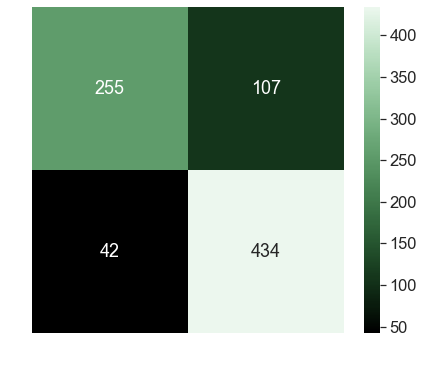

In [111]:
from sklearn.metrics import ConfusionMatrixDisplay
cf_matrix = confusion_matrix(y_test, final_test_classes)

import seaborn as sns
%matplotlib inline
sns.set(font_scale = 1.5)
plt.figure(figsize=(7,6))
sns.heatmap(cf_matrix, annot=True, fmt='d', cmap=sns.cubehelix_palette(start=2, rot=0, dark=0, light=.95, reverse=True, as_cmap=True)
)
plt.tick_params(axis='x', colors='white')
plt.tick_params(axis='y', colors='white')


plt.savefig("conf_matrix.png", transparent=True, dpi=300)

In [88]:
missed_dangerous = test_prediction_df[(test_prediction_df.dangerous_x==1) & (test_prediction_df.preds==0)]


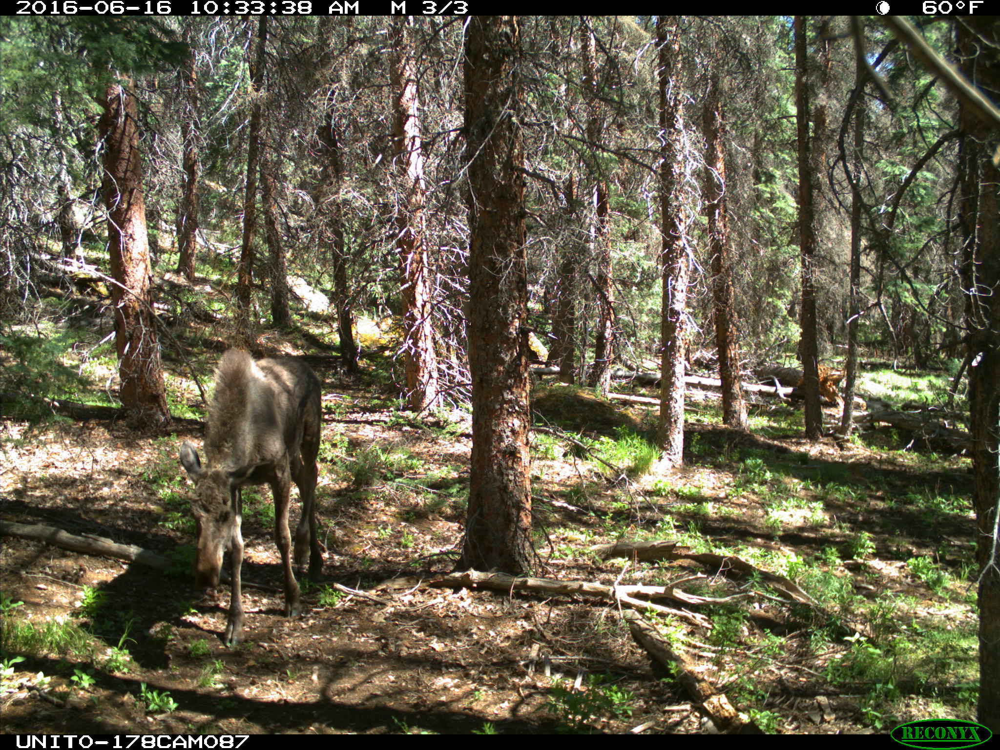

In [125]:
#index examples of model failures: 169, 2059, 2640, 4047
#index examples of justified failures: 2396, 338, 2870, 1484, 3437, 1533

Image.open('species_photos/nacti-unzipped/'+test_prediction_df.loc[4047, 'filename'])

In [126]:
test_prediction_df.loc[4047, 'filename']

'part0/sub023/2015_Unit189_Ivan087_img0441.jpg'

In [127]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4187 entries, 0 to 4186
Data columns (total 26 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Unnamed: 0        4187 non-null   int64 
 1   Unnamed: 0.1      4187 non-null   int64 
 2   Unnamed: 0.1.1    4187 non-null   int64 
 3   index             4187 non-null   int64 
 4   Unnamed: 0.1.1.1  4187 non-null   int64 
 5   seq_no            4187 non-null   int64 
 6   id                4187 non-null   object
 7   filename          4187 non-null   object
 8   study_x           3965 non-null   object
 9   location_x        3965 non-null   object
 10  width_x           4187 non-null   int64 
 11  height_x          4187 non-null   int64 
 12  category_id       4187 non-null   int64 
 13  name              4187 non-null   object
 14  genus             3965 non-null   object
 15  family            3965 non-null   object
 16  order             3965 non-null   object
 17  class         

# Attempting Image Augmentation

In [ ]:
filenamedf = pd.DataFrame(df['filename'])

In [ ]:
x_tr_df = pd.DataFrame(x_tr)
y_tr_df = pd.DataFrame(y_tr_notnumpy)
x_tr_filenames = x_tr_df.merge(filenamedf, how='left', left_index=True, right_index=True)
x_tr_filenames_withy = x_tr_filenames.merge(y_tr_df,how='left', left_index=True, right_index=True)
x_tr_filenames_withy['dangerous'] = x_tr_filenames_withy['dangerous'].astype(str)
x_tr_filenames_withy.info()

x_tr_filenames_withy.head(3)

In [ ]:
x_val_df = pd.DataFrame(x_val)
y_val_df = pd.DataFrame(y_val_notnumpy, columns=['dangerous'])
x_val_filenames = x_val_df.merge(filenamedf, how='left', left_index=True, right_index=True)
x_val_filenames_withy = x_val_filenames.merge(y_val_df,how='left', left_index=True, right_index=True)
x_val_filenames_withy['dangerous'] = x_val_filenames_withy['dangerous'].astype(str)
x_val_filenames_withy.info()

x_val_filenames_withy.head(3)

In [ ]:
from keras_preprocessing.image import ImageDataGenerator

datagen=ImageDataGenerator(
            validation_split=0.25,
            brightness_range=[.7,1.3],
#             zoom_range=[0.6,0.9],
            horizontal_flip=True)


train_generator=datagen.flow_from_dataframe(
                    dataframe=x_tr_filenames_withy,
                    directory='species_photos/nacti-unzipped/',
                    x_col="filename",
                    y_col="dangerous",
                    subset="training",
                    batch_size=10,
                    seed=5,
                    shuffle=True,
                    class_mode="binary",
                    target_size=(224,224))

valid_generator=datagen.flow_from_dataframe(
                    dataframe=x_tr_filenames_withy,
                    directory='species_photos/nacti-unzipped/',
                    x_col="filename",
                    y_col="dangerous",
                    subset="validation",
                    batch_size=10,
                    seed=5,
                    shuffle=True,
                    class_mode="binary",
                    target_size=(224,224))

# #test generator will use my validation split dataset
# test_datagen=ImageDataGenerator()
# test_generator=test_datagen.flow_from_dataframe(
#                 dataframe=x_val_filenames_withy,
#                 directory='species_photos/nacti-unzipped/',
#                 x_col="filename",
#                 y_col='dangerous',
#                 batch_size=20,
#                 seed=5,
#                 shuffle=False,
#                 class_mode='binary',
#                 target_size=(224,224))



In [ ]:
# img = load_img('species_photos/nacti-unzipped/part1/sub161/FL-08_03_07_2016_FL-08_0019247.JPG')  # this is a PIL image
# img_x = img_to_array(img)  # this is a Numpy array with shape (3, 150, 150)
# img_x = img_x.reshape((1,) + img_x.shape)  # this is a Numpy array with shape (1, 3, 150, 150)

# # the .flow() command below generates batches of randomly transformed images
# # and saves the results to the `preview/` directory
# i = 0
# for batch in datagen.flow(img_x, batch_size=1,
#                           save_to_dir='preview', save_prefix='pic', save_format='jpeg'):
#     i += 1
#     if i > 20:
#         break 

In [ ]:
base_model2 = mobilenet_v2.MobileNetV2(weights='imagenet', include_top=False, input_shape=(224,224,3)) 
for layer in base_model2.layers:
    layer.trainable = False  

x2 = base_model2.output
# x2 = Conv2D(filters=10, kernel_size=3, activation='relu', padding='same')(x2)

# x2 = Conv2D(filters=20, kernel_size=3, activation='relu', padding='same')(x2)
# x2 = Conv2D(filters=30, kernel_size=3, activation='relu', padding='same')(x2)

# x2 = MaxPooling2D()(x2)
x2 = Flatten()(x2)
x2 = Dense(100, activation='relu')(x2)
x2 = Dense(50, activation='relu')(x2)
predictions2 = Dense(1, activation='sigmoid')(x2)

transfer_model_augmented = Model(inputs=base_model2.input, outputs=predictions2)
optimizer = keras.optimizers.Adam(learning_rate=0.01)
transfer_model_augmented.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy', 'Precision', 'Recall'])
transfer_model_augmented.summary()


In [ ]:
STEP_SIZE_TRAIN=train_generator.n//train_generator.batch_size
STEP_SIZE_VALID=valid_generator.n//valid_generator.batch_size

transfer_model_augmented.fit(train_generator,
                    steps_per_epoch=STEP_SIZE_TRAIN,
                    validation_data=valid_generator,
                    validation_steps=STEP_SIZE_VALID,
                    epochs=40, callbacks=[
                    tensorflow.keras.callbacks.EarlyStopping(patience=12, verbose=1, restore_best_weights=True),
                    keras.callbacks.ReduceLROnPlateau(factor=.5, patience=6, verbose=1),
                    tensorflow.keras.callbacks.ModelCheckpoint('models/mnist.{epoch:02d}-{val_loss:.2f}.hdf5',
                    save_best_only=True)])

In [ ]:
augmented_preds = transfer_model_augmented.predict(x_val_stacked).flatten()
augmented_pred_classes = np.int8(augmented_preds >= .5)

print('Accuracy:', accuracy_score(y_val, augmented_pred_classes))
print('Precision:', precision_score(y_val, augmented_pred_classes))
print('Recall:', recall_score(y_val,augmented_pred_classes))

In [ ]:
x_tr[1]

In [ ]:
train_generator[0]

In [ ]:
x_tr_filenames_withy.head(5)